In [16]:
from selenium import webdriver
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.common.by import By
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.webdriver import ActionChains
from selenium.webdriver.chrome.service import Service
import pyautogui
import time
import pandas as pd
import re
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sb
from time import localtime, strftime
import bs4
import requests
import os

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import RandomOverSampler

# Thu thập dữ liệu

In [ ]:
#ham crawl du lieu cua 1 ngay

def crawl_one_day(day_text, driver):
    find_day = driver.find_element(By.NAME, "ctl00$MainContentHolder$txtPastDate")
    
    find_day.send_keys(day_text)
    find_day.send_keys(Keys.ENTER)
    
    table = driver.find_element(By.CLASS_NAME, "days-details-table")
    rows = table.find_elements(By.CLASS_NAME, "days-details-row")[1::]
    
    data_one = []
    for row in rows:
        data = re.split('\n| ', row.text) + [day_text[0:2], day_text[2:4], day_text[4::]]
        data.append(row.find_element(By.CLASS_NAME, "days-table-forecast-img").get_attribute('alt'))
        data_one.append(data)
        
    return data_one

In [20]:
def crawl_one_year(y, driver):
    if ((y%4 == 0)|(y%400==0)):
        ferb_day = 30
    else:
        ferb_day = 29
        
    day = [ [0],
            range(1,32),
            range(1,ferb_day),
            range(1,32),
            range(1,31),
            range(1,32),
            range(1,31),
            range(1,32),
            range(1,32),
            range(1,31),
            range(1,32),
            range(1,31),
            range(1,32)]   
     
    data = []
    for m in range(1,13):
        if ((m==10)&(y==2024)):
            break
         
        for d in day[m]:
            if (d<10):
                d = f"0{d}"
            if (m<10):
                m_str = f"0{m}"
                day_text = f"{d}{m_str}{y}"
            else:
                day_text = f"{d}{m}{y}"
            
              
            data = data + crawl_one_day(day_text, driver)
    
    return data        
    

In [23]:
#chromedriver can dung voi phien ban hien tai cua may: https://sites.google.com/chromium.org/driver/downloads
service = Service(executable_path="E:\Docs\HCMC weather forecast\chromedriver.exe")
driver = webdriver.Chrome(service=service)
driver.get("https://www.worldweatheronline.com/ho-chi-minh-city-weather-history/vn.aspx")
time.sleep(1)

for year in range(2020, 2025):
    data_one_year = crawl_one_year(year, driver)
    df = pd.DataFrame(data_one_year)
    df.to_csv('E:\\Docs\\HCMC weather forecast\\crawl data\\' + f'{year}.csv', index=False, encoding='utf-8-sig')

time.sleep(1)
driver.close()

KeyboardInterrupt: 

# Tổng hợp dữ liệu

In [ ]:
#doc du lieu tu cac file csv
directory = os.path.join("E:\Docs\HCMC weather forecast\crawl data")
metadata = pd.DataFrame()
for root,dirs,files in os.walk(directory):
    for file in files:
       if file.endswith(".csv"):
           data = pd.read_csv(os.path.join(root, file))
           metadata = pd.concat([metadata, data], axis=0)
metadata.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5840 entries, 0 to 2919
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       5840 non-null   object 
 1   1       5840 non-null   int64  
 2   2       5840 non-null   object 
 3   3       5840 non-null   int64  
 4   4       5840 non-null   object 
 5   5       5840 non-null   float64
 6   6       5840 non-null   object 
 7   7       5840 non-null   object 
 8   8       5840 non-null   object 
 9   9       5840 non-null   int64  
 10  10      5840 non-null   object 
 11  11      5840 non-null   int64  
 12  12      5840 non-null   object 
 13  13      5840 non-null   int64  
 14  14      5840 non-null   object 
 15  15      5840 non-null   int64  
 16  16      5840 non-null   int64  
 17  17      5840 non-null   int64  
 18  18      5840 non-null   object 
dtypes: float64(1), int64(8), object(10)
memory usage: 912.5+ KB


In [25]:
metadata

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18
0,00,25,°c,26,°c,0.0,mm,0,26,1013,mb,8,km/h,13,km/h,1,1,2022,Partly cloudy
1,03,24,°c,25,°c,0.0,mm,0,28,1012,mb,7,km/h,11,km/h,1,1,2022,Partly cloudy
2,06,23,°c,25,°c,0.0,mm,0,33,1013,mb,8,km/h,13,km/h,1,1,2022,Partly cloudy
3,09,25,°c,27,°c,0.0,mm,0,47,1015,mb,5,km/h,11,km/h,1,1,2022,Partly cloudy
4,12,28,°c,30,°c,0.0,mm,0,34,1013,mb,4,km/h,9,km/h,1,1,2022,Partly cloudy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2915,09,29,°c,31,°c,0.0,mm,0,47,1013,mb,9,km/h,10,km/h,31,12,2023,Clear
2916,12,33,°c,36,°c,0.0,mm,0,44,1011,mb,8,km/h,9,km/h,31,12,2023,Clear
2917,15,33,°c,36,°c,0.0,mm,0,48,1008,mb,2,km/h,3,km/h,31,12,2023,Partly cloudy
2918,18,28,°c,31,°c,0.0,mm,0,23,1009,mb,16,km/h,25,km/h,31,12,2023,Clear


In [24]:
for i in range(len(metadata)):
  metadata['0'][i]=metadata['0'].iloc[i][:-3]
  metadata['7'][i]=metadata['7'].iloc[i][:-1]
  metadata['8'][i]=metadata['8'].iloc[i][:-1]

C:\Users\nife\AppData\Local\Temp\ipykernel_9604\3666424902.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  metadata['0'][i]=metadata['0'].iloc[i][:-3]
C:\Users\nife\AppData\Local\Temp\ipykernel_9604\3666424902.py:2: SettingWithCopyWarnin

In [26]:
metadata.rename({'0':'Hour','1':'Temperature','3':'Forecast','5':'Rain','7':'Rain_rate','9':'Pressure','8':'Cloud_rate','11':'Wind','13':'Gust','15':'Day','16':'Month','17':'Year','18':'Weather'},
            axis = "columns", inplace = True)

In [27]:
metadata.Hour = metadata.Hour.astype(int)
metadata.Temperature = metadata.Temperature.astype(float)
metadata.Forecast	= metadata.Forecast.astype(float)
metadata.Rain = metadata.Rain.astype(float)
metadata.Rain_rate = metadata.Rain_rate.astype(float)
metadata.Rain_rate = metadata.Rain_rate/100
metadata.Cloud_rate = metadata.Cloud_rate.astype(float)
metadata.Cloud_rate = metadata.Cloud_rate/100
metadata.Pressure = metadata.Pressure.astype(float)
metadata.Wind = metadata.Wind.astype(float)
metadata.Gust = metadata.Gust.astype(float)

In [36]:
metadata = metadata.drop(['2','4','6','10','12','14'],axis=1)
metadata

KeyError: "['2', '4', '6', '10', '12', '14'] not found in axis"

In [37]:
metadata.to_csv('E:\\Docs\\HCMC weather forecast\\metadata.csv', index=False, encoding='utf-8-sig')

In [32]:
norain = ['Clear', 'Cloudy', 'Overcast', 'Partly cloudy', 'Thundery outbreaks possible']
rain = ['Heavy rain at times' , 'Light rain shower', 'Moderate or heavy rain shower', 'Moderate rain at times', 'Patchy light rain with thunder', 'Patchy rain possible',
        'Mist', 'Patchy light drizzle', 'Light drizzle', 'Fog', 'Patchy light rain', 'Light rain', 'Moderate rain']

In [33]:
metadata = metadata.replace(norain, 0)
metadata = metadata.replace(rain, 1)
metadata['Weather'].value_counts()

C:\Users\nife\AppData\Local\Temp\ipykernel_9604\2219405521.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  metadata = metadata.replace(rain, 1)


Weather
0    3781
1    2059
Name: count, dtype: int64

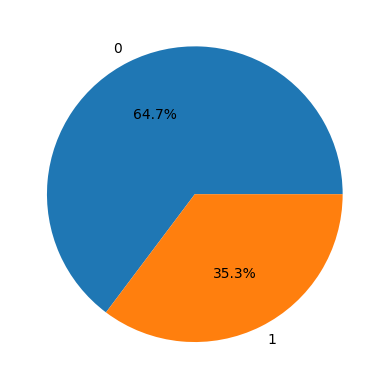

,Hour,Temperature,Forecast,Rain,Rain_rate,Cloud_rate,Pressure,Wind,Gust,Day,Month,Year
Weather,,,,,,,,,,,,
0,3781,3781,3781,3781,3781,3781,3781,3781,3781,3781,3781,3781
1,2059,2059,2059,2059,2059,2059,2059,2059,2059,2059,2059,2059


In [34]:
plt.pie(metadata['Weather'].value_counts().values,
        labels = metadata['Weather'].value_counts().index,
        autopct='%1.1f%%')
plt.show()
metadata.groupby(['Weather']).count()

In [35]:
features = list(metadata.select_dtypes(include = np.number).columns)
rm = ['Hour','Day','Month','Year','Weather']
features = [i for i in features if i not in rm]
print(features)

['Temperature', 'Forecast', 'Rain', 'Rain_rate', 'Cloud_rate', 'Pressure', 'Wind', 'Gust']


C:\Users\nife\AppData\Local\Temp\ipykernel_22064\3544685936.py:5: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3,4, i + 1)
C:\Users\nife\AppData\Local\Temp\ipykernel_22064\3544685936.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(metadata[col])
C:\Users\nife\AppData\Local\Temp\ipykernel_22064\3544685936.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or

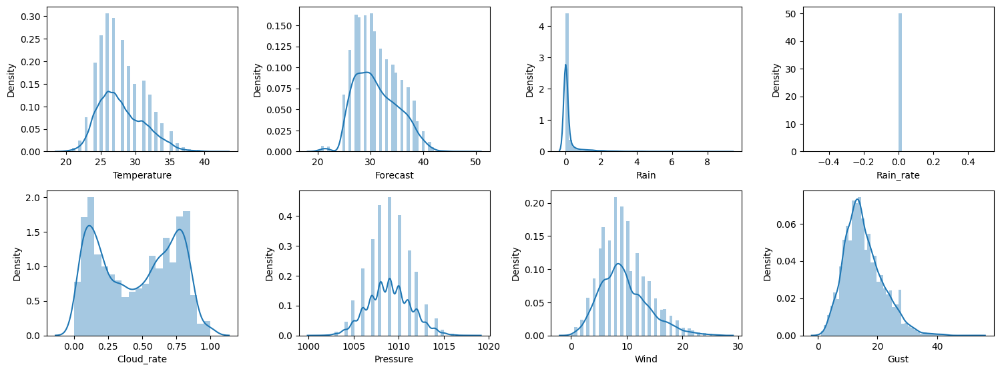

In [ ]:
plt.subplots(figsize=(15,8))
 
for i, col in enumerate(features):
  plt.subplot(3,4, i + 1)
  sb.distplot(metadata[col])
plt.tight_layout()
plt.show()

In [88]:
metadata.to_csv("final_data.csv", index=False)

# Đọc và chuẩn bị dữ liệu

In [2]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
#Đọc dữ liệu
data = pd.read_csv('final_data.csv')
data

,Hour,Temperature,Forecast,Rain,Rain_rate,Cloud_rate,Pressure,Wind,Gust,Day,Month,Year,Weather
0,0,26.0,28.0,0.0,0.0,0.10,1015.0,8.0,11.0,1,1,2020,0
1,3,25.0,26.0,0.0,0.0,0.19,1014.0,8.0,13.0,1,1,2020,0
2,6,24.0,26.0,0.0,0.0,0.10,1015.0,8.0,11.0,1,1,2020,0
3,9,29.0,30.0,0.0,0.0,0.05,1016.0,7.0,15.0,1,1,2020,0
4,12,34.0,34.0,0.0,0.0,0.08,1015.0,10.0,17.0,1,1,2020,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9723,9,32.0,36.0,0.0,0.0,0.65,1010.0,12.0,14.0,30,4,2023,0
9724,12,37.0,42.0,0.0,0.0,0.46,1007.0,9.0,10.0,30,4,2023,0
9725,15,33.0,37.0,0.4,0.0,0.45,1005.0,12.0,15.0,30,4,2023,1
9726,18,30.0,33.0,0.7,0.0,0.24,1006.0,17.0,26.0,30,4,2023,1


In [91]:
# #Cách 1
# features = data.drop(['Weather'], axis=1)
# target = data.Weather

In [92]:
#Cách 2
features = data.drop(['Weather'], axis=1).iloc[:-1, :]
target = data.Weather.iloc[1:]

In [93]:
# # Cách 3
# features = data.drop(['Day', 'Month', 'Year', 'Weather'], axis=1).iloc[:-1, :]
# target = data.Weather.iloc[1:]

In [94]:
# # Cách 4
# features = data.drop(['Day', 'Year', 'Weather'], axis=1).iloc[:-1, :]
# target = data.Weather.iloc[1:]

# rain_ss = [5,6,7,8,9,10,11]
# norain_ss = [12,1,2,3,4]
# features['Month'] = features['Month'].replace(norain_ss, 0)
# features['Month'] = features['Month'].replace(rain_ss, 1)
# features['Month'].value_counts()

In [95]:
features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9727 entries, 0 to 9726
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Hour         9727 non-null   int64  
 1   Temperature  9727 non-null   float64
 2   Forecast     9727 non-null   float64
 3   Rain         9727 non-null   float64
 4   Rain_rate    9727 non-null   float64
 5   Cloud_rate   9727 non-null   float64
 6   Pressure     9727 non-null   float64
 7   Wind         9727 non-null   float64
 8   Gust         9727 non-null   float64
 9   Day          9727 non-null   int64  
 10  Month        9727 non-null   int64  
 11  Year         9727 non-null   int64  
dtypes: float64(8), int64(4)
memory usage: 912.0 KB


In [97]:
target.info()

<class 'pandas.core.series.Series'>
RangeIndex: 9727 entries, 1 to 9727
Series name: Weather
Non-Null Count  Dtype
--------------  -----
9727 non-null   int64
dtypes: int64(1)
memory usage: 76.1 KB


In [98]:

X_train, X_val, Y_train, Y_val = train_test_split(features,
                                                  target,
                                                  test_size = 0.2,
                                                  stratify = target,
                                                  random_state=2)
 
# lặp lại các dòng dữ liệu có số lượng label thấp hơn để tăng tính cân bằng
ros = RandomOverSampler(sampling_strategy='minority', random_state=22)
X, Y = ros.fit_resample(X_train,Y_train)

In [101]:
# chuẩn hóa toàn bộ dữ liệu
scaler = StandardScaler()
X = scaler.fit_transform(X)
X_val = scaler.transform(X_val)

# Chạy các mô hình máy học

In [102]:
models = [LogisticRegression(), XGBClassifier(), SVC(probability=True)]

for i in range(3):
  st = time.time()
  models[i].fit(X, Y)
  et = time.time()

  print(f'{models[i]} : ')

  train_preds = models[i].predict_proba(X)
  print('Training Accuracy : ', metrics.roc_auc_score(Y, train_preds[:,1]))

  val_preds = models[i].predict_proba(X_val)
  print('Validation Accuracy : ', metrics.roc_auc_score(Y_val, val_preds[:,1]))

  print("Time: ", et-st)

  # cm = metrics.confusion_matrix(Y_val, models[i].predict(X_val), labels=models[i].classes_)
  # disp = metrics.ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=models[i].classes_)
  # disp.plot()
  print("==========================================================")



LogisticRegression() : 
Training Accuracy :  0.8128067100373941
Validation Accuracy :  0.8166253101736972
Time:  0.016997575759887695
XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...) : 
Training Accuracy :  0.9944336385086422
Validation Accuracy :  0.8629369403387637
Time:  0.18399858474731445
SV

In [16]:
print(metrics.classification_report(Y_val, models[1].predict(X_val), digits=5))

              precision    recall  f1-score   support

           0    0.94637   0.90488   0.92516      2418
           1    0.76861   0.86036   0.81190       888

    accuracy                        0.89292      3306
   macro avg    0.85749   0.88262   0.86853      3306
weighted avg    0.89862   0.89292   0.89474      3306



# Demo

In [17]:
def get_page_content(url):
   page = requests.get(url,headers={"Accept-Language":"en-US"})
   return bs4.BeautifulSoup(page.text,"html.parser")

In [107]:
real_time = strftime("%Y-%m-%d %H:%M:%S", localtime())
year, month, day, hour = real_time[0:4], real_time[5:7], real_time[8:10], real_time[11:13]
print(strftime("%Y-%m-%d %H:%M:%S", localtime()))

url = f'https://www.worldweatheronline.com/ho-chi-minh-city-weather/vn.aspx?day={day}&tp=1' #link website
soup = get_page_content(url)
weather_now = soup.findAll('tr')[int(hour)+2].get_text()
data_test = re.split(':00| °c|mm|%|mb| km/h', weather_now)[:-1]
data_test = list(map(float, data_test))
data_test.extend([day, month, year])
data_test[4], data_test[5] = data_test[4]/100, data_test[5]/100
datatest = [data_test]

datatest = scaler.transform(datatest)
y_test = models[1].predict(datatest)

if y_test[0]==0:
    print("Trong 3 tiếng nữa sẽ không có mưa!")
else:
    print("Trong 3 tiếng nữa sẽ có mưa!")

2023-07-01 00:47:43
Trong 3 tiếng nữa sẽ không có mưa!


c:\Users\nife\miniconda3\envs\DS103\lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
